<a href="https://colab.research.google.com/github/GWU-CS2021/CSCI6364/blob/main/project%20phase2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [28]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

## This code is highly inspired by https://github.com/phillipi/pix2pix
## Skipped rubrics
- For the rubric, 19-23,27-32 doesn't apply well for GAN model

## Import TensorFlow and other libraries

In [29]:
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

## Unzip the data with predefined test and train split

In [30]:

!unzip data.zip

Archive:  data.zip
replace test/female00001.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


## Check image in dataset

In [31]:
sample_image = tf.io.read_file("test/female00002.png")
sample_image = tf.io.decode_png(sample_image)
print(sample_image.shape)

(133, 160, 4)


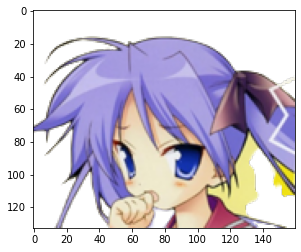

In [32]:
plt.figure()
plt.imshow(sample_image)

## Add image conversion code from phase 1 to generate draft from ground truth

In [33]:
import cv2

def load(image_file):
  try:
    image_file = image_file.numpy().decode("utf-8")
  except:
    pass
  #image = tf.io.read_file(image_file)
  #image = tf.image.decode_png(image)
  #print(image_file_str)+"123"
  img = cv2.imread(image_file,cv2.IMREAD_UNCHANGED)
  try:
    trans_mask = img[:,:,3] == 0

  #replace areas of transparency with white and not transparent
    img[trans_mask] = [255, 255, 255, 255]
  except:
    pass

  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  border_v = 0
  border_h = 0
  if (1) >= (img.shape[0]/img.shape[1]):
    border_v = int((((1)*img.shape[1])-img.shape[0])/2)
  else:
    border_h = int((((1)*img.shape[0])-img.shape[1])/2)
  img = cv2.copyMakeBorder(img, border_v, border_v, border_h, border_h, cv2.BORDER_REPLICATE, 0)
  img = cv2.resize(img, (256, 256))
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  img_invert = cv2.bitwise_not(img_gray)



  img_smoothing = cv2.GaussianBlur(img_invert, (21, 21),sigmaX=0, sigmaY=0)
  final = cv2.divide(img_gray, 255 - img_smoothing, scale=255)
  f = cv2.bitwise_not(final)
  (thresh, blackAndWhiteImage) = cv2.threshold(f, 1, 255, cv2.THRESH_BINARY)
  blackAndWhiteImage = cv2.bitwise_not(blackAndWhiteImage)
  blackAndWhiteImage = cv2.cvtColor(blackAndWhiteImage,cv2.COLOR_BGR2RGB)

  input_image,real_image = tf.convert_to_tensor(blackAndWhiteImage, dtype=tf.float32),tf.convert_to_tensor(img, dtype=tf.float32)


  return input_image, real_image

## Show Generated draft and ground truth

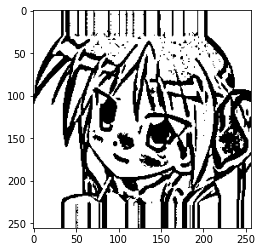

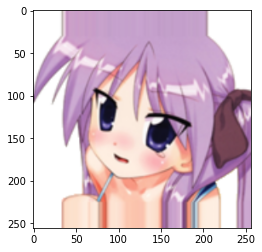

In [34]:
inp, re = load("test/female00001.png")
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

# 24.	For images, define a list of image transformations to be used during training, passing them to transforms.Compose(). For text and tabular data, discuss what pre-processing you used. Discuss why you think these transformations might help.

1. Resize each `256 x 256` image to a larger height and width—`286 x 286`.
2. Randomly crop it back to `256 x 256`.
3. Randomly flip the image horizontally i.e. left to right (random mirroring).
4. Normalize the images to the `[-1, 1]` range.
- These step added more training variation to the dataset(free data)

In [35]:
# The facade training set consist of 400 images
BUFFER_SIZE = 200
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [36]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [37]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [38]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [39]:
@tf.function()
def random_jitter(input_image, real_image):
  # Resizing to 286x286
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # Random cropping back to 256x256
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

Some jittered images shown as below

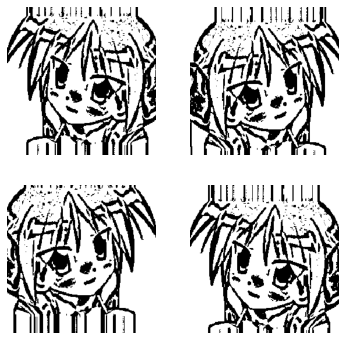

In [40]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

Define helper function for loading train and test dataset

In [41]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [42]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

## 26. Correctly set up DataLoaders for the three folders (train, validation, holdout). Discuss what options you chose for these loaders, and why (including batch size, shuffling, and dropping last).

- Build an input pipeline using lambda map with `tf.data` for faster parallel loading
- Shuffling is applied
- Batch size is set to 1 according to the best practise in pix2pix

In [43]:
def parse_func(filename):
    out,out2 = tf.py_function(load_image_train, [filename], (tf.float32,tf.float32))
    return out,out2

train_dataset = tf.data.Dataset.list_files('train/female*.png')
train_dataset = train_dataset.map(parse_func,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [44]:
def parse_func2(filename):
    out,out2 = tf.py_function(load_image_test, [filename], (tf.float32,tf.float32))
    return out,out2

test_dataset = tf.data.Dataset.list_files('test/female*.png')
test_dataset = test_dataset.map(parse_func2)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Build the generator

The generator of pix2pix cGAN is a _modified_ [U-Net](https://arxiv.org/abs/1505.04597). A U-Net consists of an encoder (downsampler) and decoder (upsampler).

- Each block in the encoder is: Convolution -> Batch normalization -> Leaky ReLU
- Each block in the decoder is: Transposed convolution -> Batch normalization -> Dropout (applied to the first 3 blocks) -> ReLU
- There are skip connections between the encoder and decoder (as in the U-Net).

Define the downsampler (encoder):

In [45]:
OUTPUT_CHANNELS = 3

In [46]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [47]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

(1, 128, 128, 3)


Define the upsampler (decoder):

In [48]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [49]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


Define the generator with the downsampler and the upsampler:

In [50]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

generator = Generator()

Visualize the generator model architecture:

Test the generator:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


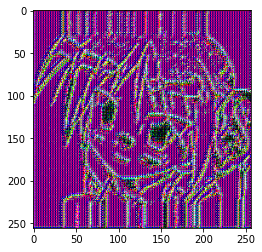

In [51]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

### Define the generator loss

GANs learn a loss that adapts to the data, while cGANs learn a structured loss that penalizes a possible structure that differs from the network output and the target image

- The generator loss is a sigmoid cross-entropy loss of the generated images and an **array of ones**.
- The pix2pix paper also mentions the L1 loss, which is a MAE (mean absolute error) between the generated image and the target image.
- This allows the generated image to become structurally similar to the target image.
- The formula to calculate the total generator loss is `gan_loss + LAMBDA * l1_loss`, where `LAMBDA = 100`. This value was decided by the authors of the paper.

In [52]:
LAMBDA = 100

In [53]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [54]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

### Define the discriminator loss

- The `discriminator_loss` function takes 2 inputs: **real images** and **generated images**.
- `real_loss` is a sigmoid cross-entropy loss of the **real images** and an **array of ones(since these are the real images)**.
- `generated_loss` is a sigmoid cross-entropy loss of the **generated images** and an **array of zeros (since these are the fake images)**.
- The `total_loss` is the sum of `real_loss` and `generated_loss`.

In [55]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

# 34.	Choose and instantiate a loss function. Discuss your choice.
- The loss function used in GAN consist two parts - the generator loss and the discriminator loss.
- The generator loss is consist of gan loss and mean absolute error to ground truth
- The discriminator loss is to deterimine how real the image generated.

## Build the discriminator

The discriminator in the pix2pix cGAN is a convolutional PatchGAN classifier—it tries to classify if each image _patch_ is real or not real

- Each block in the discriminator is: Convolution -> Batch normalization -> Leaky ReLU.
- The shape of the output after the last layer is `(batch_size, 30, 30, 1)`.
- Each `30 x 30` image patch of the output classifies a `70 x 70` portion of the input image.
- The discriminator receives 2 inputs: 
    - The input image and the target image, which it should classify as real.
    - The input image and the generated image (the output of the generator), which it should classify as fake.
    - Use `tf.concat([inp, tar], axis=-1)` to concatenate these 2 inputs together.

define the discriminator:

In [56]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

discriminator = Discriminator()

Test the discriminator:

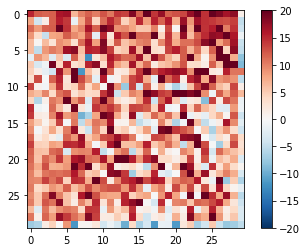

In [57]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

# 15:Instantiate a model of your choosing.

# 16:Define a grid to tune at least three different hyperparameters with at least two different values each. Discuss why you think these parameter values might be useful for this dataset.
# 17:Set up a gridsearchCV with 5-fold cross validation (scikit-learn) or equivalent in PyTorch. Discuss what accuracy metric you chose and why.
# 18:Train your model using grid search (or equivalent), and report the best performing hyperparameters.
- Currently I would think of tuning the level of upsample and downsample in the generator model would help to achieve a better training result. But I'm not sure how this part works in GAN model. So I tempory skipped this part. 

## Define the optimizers and a checkpoint-saver


In [58]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# 33.	Choose and instantiate an optimizer. Discuss your choice.
ADAM(adaptive moment estimation) is the most commonly used optimizer used currently. This optimizer uses momentum estimation to find minimum quicker than other optimizers. The parameters in the optimizer are from pix2pix best practise. 

In [59]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generate images

Write a function to plot some images during training.

- Pass images from the test set to the generator.
- The generator will then translate the input image into the output.

In [60]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Test the function:

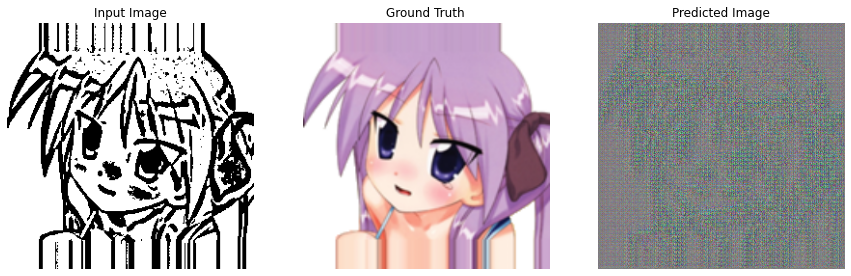

In [61]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Training

- For each example input generates an output.
- The discriminator receives the `input_image` and the generated image as the first input. The second input is the `input_image` and the `target_image`.
- Next, calculate the generator and the discriminator loss.
- Then, calculate the gradients of loss with respect to both the generator and the discriminator variables(inputs) and apply those to the optimizer.
- Finally, log the losses to TensorBoard.

In [62]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [63]:

@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//500)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//500)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//500)
    tf.summary.scalar('disc_loss', disc_loss, step=step//500)

# 39.	Correctly choose a loss function and back-propagate its results.
# 40.	Use the optimizer correctly to update weights/gradients.
- generator_optimizer and discriminator_optimizer are used to apply gradients to the model.

# 41.	Correctly record training losses for each epoch.
- loss is recorded in avg in 500 steps using `tf.summary.scalar`


In [64]:
def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

# 42. Correctly set up validation at each epoch.
- Model will predict a image in test dataset using it's current weights every 1000 steps.

# 43.	Correctly record validation losses for each epoch.
- For GAN models, validation losses is the loss for discriminator. which is saved in `disc_loss`

# 44.	Correctly record training and validation accuracies for each epoch
- The Accuracies is quiet hard to evaluate in GAN models, but the `gen_l1_loss` which is the absolute error towards the ground truth, can somehow represent the accuracy of the GAN model.

# 45.	Graph training versus validation loss using matplotlib.pyplot (or other). Was your model overfitting, underfitting, or neither?
- Loss is visuallized using `TensorBoard` The Loss is still going down in the training process so it's not overfitting yet.


In [65]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

# 35.	Write code that places the model on the GPU, if it exists, otherwise using the CPU.
- Tensorflow uses unified codebase for GPU and CPU training

# 36.	Correctly set up your model to train over 20 epochs.
- I used 4000 steps for testing here. In formal training I would consider around 100k steps 

# 37.	Correctly set up your model to use your batches for training.
- Currently the best practise from pix2pix is using batch size as 1 to train models.


Finally, run the training loop:

Time taken for 1000 steps: 176.86 sec



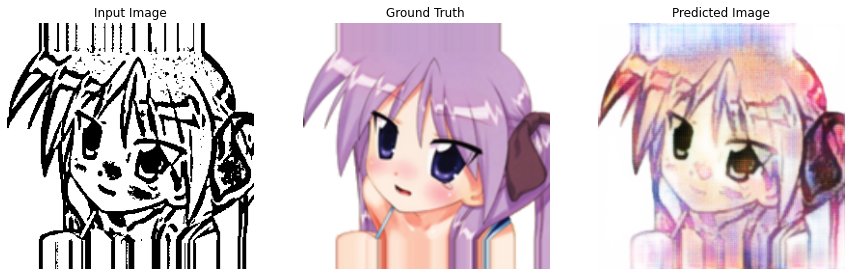

Step: 9k
....................................................................................................

In [66]:
fit(train_dataset, test_dataset, steps=10000)

## Restore the latest checkpoint and test the network

In [67]:
!ls {checkpoint_dir}

checkpoint		    ckpt-1.index		ckpt-2.index
ckpt-1.data-00000-of-00001  ckpt-2.data-00000-of-00001


In [68]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

# 38.	Correctly make predictions with your model (the predictions can be wrong)

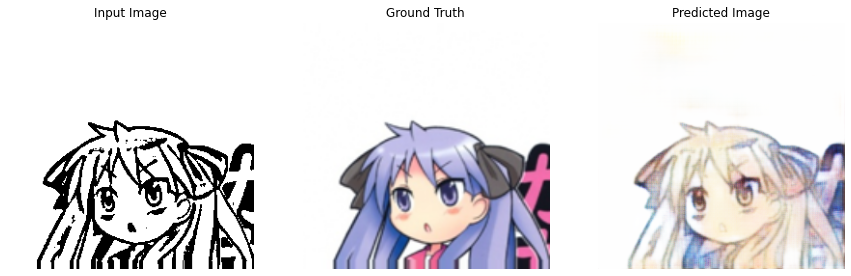

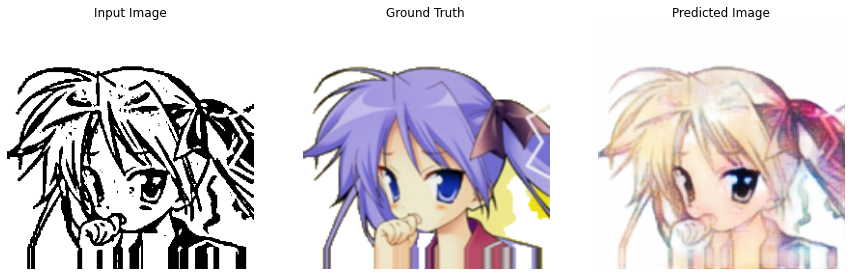

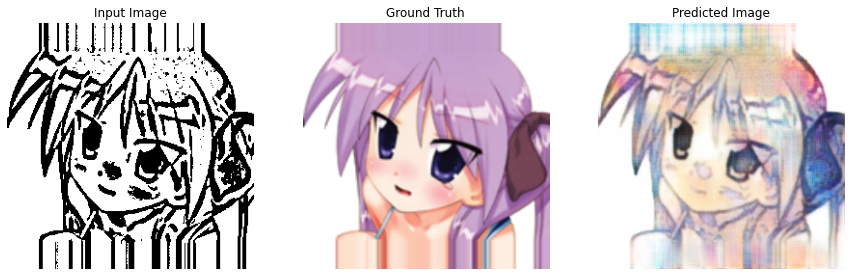

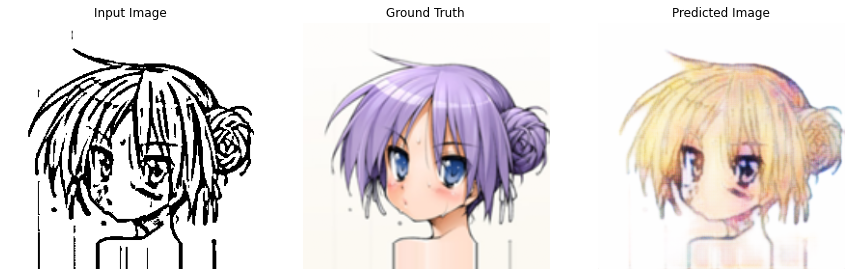

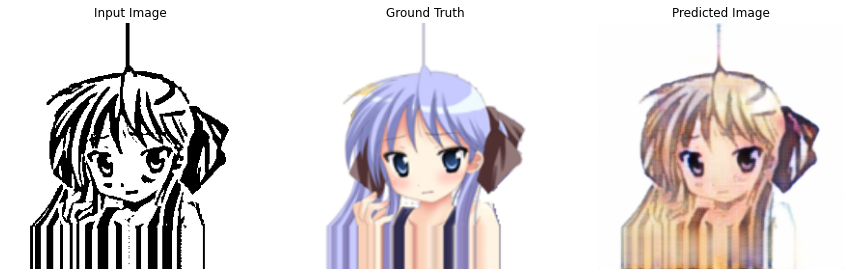

In [69]:
# Run the trained model on a few examples from the test set
for inp, tar in test_dataset.take(5):
  generate_images(generator, inp, tar)

# 46.	Make a list of reasons why your model may have under-performed.
- The current training dataset only have 500 images which is rather small for GAN model
- The input used in the training process is auto generated from ground truth. This might have some side effect on the training.
- The training step is only 4000. An ideal training length for GAN model should be around 100k steps.
- The parameters used in this GAN model is from the best practise from pix2pix paper. In which they are mostly generating real world pictures. And in our case, the anime characters are a lot different. This difference also might have some unknown effect in the result.


# 47.	Make a list of ways you could improve your model performance (you don't have to implement these unless you wan to).	
- Add more image into the training set
- Use more complicated way for generating human like drawing for training input
- Increase the training step included in the training process.(Need more compute power)
- Gain a deeper understanding of the model. Fine tune the model to best fit for generating anime drawing.

# 48.	Graph training versus validation accuracy using matplotlib.pyplot (or other). Score your model on its predictions on the holdout. Discuss why you think your results will or will not generalize.
- From Current result I can see that although not perfect, it still shows some sort of generalization. Like the hair of the character is colored differently to their faces or clothes. This difference is the proof that this GAN model has learnt the different charaistic in anime drawing. And has dealt them differently. So I do think this reuslt will generalize.

In [70]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 205), started 0:30:37 ago. (Use '!kill 205' to kill it.)

<IPython.core.display.Javascript object>